In [1]:
%matplotlib inline

In [2]:
from __future__ import print_function

import argparse
import os
import random

import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.backends.cudnn as cudnn
import torch.nn.parallel
import torch.utils.data
import torchvision.datasets as dset
import torchvision.utils as vutils
from IPython.display import HTML
from torch import nn, optim
from torchvision import transforms

manualSeed = 999
print("Random Seed: ", manualSeed)

random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [3]:
dataroot = "data/celeba"

workers = 4
batch_size = 128

image_size = 64

nc = 3

nz = 100

ngf = 64

ndf = 64

num_epochs = 5

lr = 2e-4

beta1 = 0.5

ngpu = 1

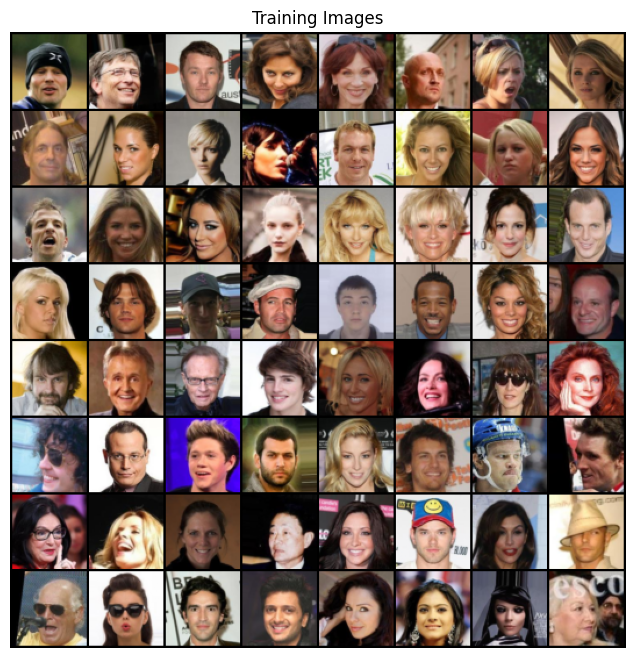

In [4]:
dataset = dset.ImageFolder(
    root=dataroot,
    transform=transforms.Compose(
        [
            transforms.Resize(image_size),
            transforms.CenterCrop(image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)

dataloader = torch.utils.data.DataLoader(
    dataset, batch_size=batch_size, shuffle=True, num_workers=workers, drop_last=True
)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(
    np.transpose(
        vutils.make_grid(
            real_batch[0].to(device)[:64], padding=2, normalize=True
        ).cpu(),
        (1, 2, 0),
    )
)

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 入力値はnzで、畳み込みが適用されます
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # サイズ：(ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # サイズ：(ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # サイズ：(ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # サイズ：(ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # サイズ： (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [7]:
netG = Generator(ngpu).to(device)

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 入力は (NC) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # サイズ：(ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # サイズ： (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # サイズ：(ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # サイズ： (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid(),
        )

    def forward(self, input):
        return self.main(input)

In [9]:
netD = Discriminator(ngpu).to(device)

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [10]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1.0
fake_label = 0.0

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        # 識別機の訓練
        # ステップ1 本物の画像を使った訓練
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        # 回答ラベルの生成 = [1,1,1,1....]
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # 本物画像の伝搬
        output = netD(real_cpu).view(-1)
        # 損失の計算
        errD_real = criterion(output, label)
        # 逆伝播
        errD_real.backward()
        D_x = output.mean().item()

        # ステップ2 偽物画像=生成器の画像を使った訓練
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # 生成器を用いて偽物画像を生成
        fake = netG(noise)
        # fill_は引数で中身abs
        label.fill_(fake_label)

        output = netD(fake.detach()).view(-1)
        # 損失の計算
        errD_fake = criterion(output, label)
        # 逆伝播
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        # すべての本物画像のバッチの勾配と、偽物画像の勾配を足す
        errD = errD_real + errD_fake
        # 識別機の更新
        optimizerD.step()

        # 生成機の訓練
        netG.zero_grad()
        label.fill_(real_label)  # 生成器の損失にとっては、偽画像ラベルが正解になる

        # 再度識別機に伝播させる
        output = netD(fake).view(-1)

        # 勾配の計算
        # 識別機が本物画像として謝る判定する=うまく生成できている
        errG = criterion(output, label)

        # 逆伝播
        errG.backward()
        D_G_z2 = output.mean().item()

        # 生成機の更新
        optimizerG.step()

        # 訓練のステータスを出力
        if i % 50 == 0:
            print(
                "[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f"
                % (
                    epoch,
                    num_epochs,
                    i,
                    len(dataloader),
                    errD.item(),
                    errG.item(),
                    D_x,
                    D_G_z1,
                    D_G_z2,
                )
            )
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # 生成器Gの出力をfixed_noiseに保存して、生成器の動作を確認
        if (iters % 500 == 0) or (
            (epoch == num_epochs - 1) and (i == len(dataloader) - 1)
        ):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training...
[0/5][0/1582]	Loss_D: 1.9100	Loss_G: 6.3751	D(x): 0.7247	D(G(z)): 0.7207 / 0.0032
[0/5][50/1582]	Loss_D: 0.2818	Loss_G: 30.9140	D(x): 0.8648	D(G(z)): 0.0000 / 0.0000
[0/5][100/1582]	Loss_D: 0.0004	Loss_G: 35.6276	D(x): 0.9996	D(G(z)): 0.0000 / 0.0000
[0/5][150/1582]	Loss_D: 0.5098	Loss_G: 6.9791	D(x): 0.7287	D(G(z)): 0.0122 / 0.0050
[0/5][200/1582]	Loss_D: 0.4720	Loss_G: 5.3305	D(x): 0.7404	D(G(z)): 0.0810 / 0.0143
[0/5][250/1582]	Loss_D: 0.7986	Loss_G: 4.9999	D(x): 0.5835	D(G(z)): 0.0375 / 0.0162
[0/5][300/1582]	Loss_D: 1.4349	Loss_G: 5.3832	D(x): 0.4082	D(G(z)): 0.0317 / 0.0201
[0/5][350/1582]	Loss_D: 0.6791	Loss_G: 6.0343	D(x): 0.9038	D(G(z)): 0.3766 / 0.0099
[0/5][400/1582]	Loss_D: 0.7013	Loss_G: 5.3780	D(x): 0.8835	D(G(z)): 0.3573 / 0.0174
[0/5][450/1582]	Loss_D: 0.5742	Loss_G: 5.2679	D(x): 0.8592	D(G(z)): 0.2762 / 0.0108
[0/5][500/1582]	Loss_D: 0.7547	Loss_G: 9.9201	D(x): 0.9341	D(G(z)): 0.4165 / 0.0001
[0/5][550/1582]	Loss_D: 0.4282	Loss_G: 4.4519	D(x): 0.74

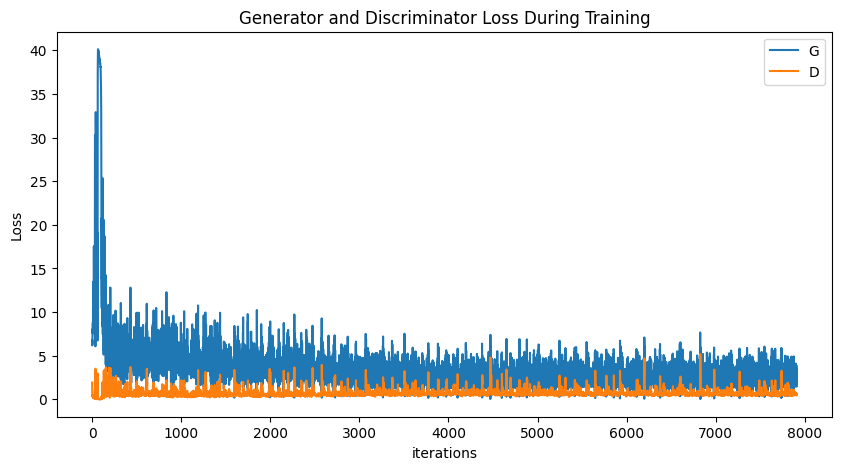

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

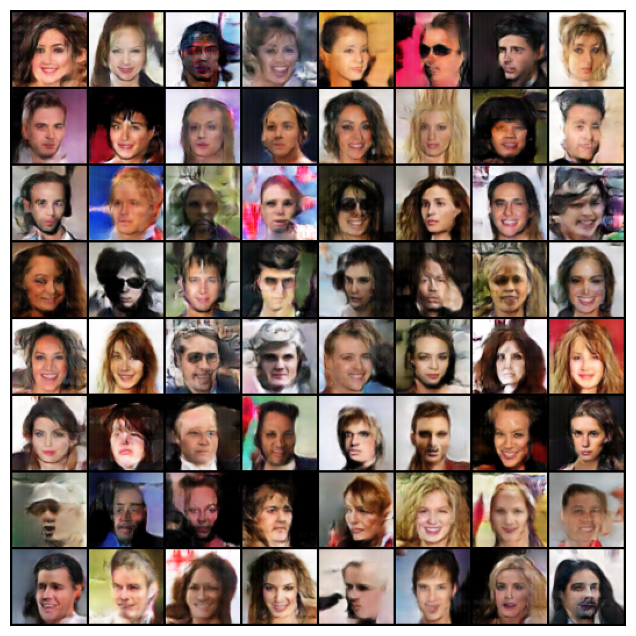

In [13]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

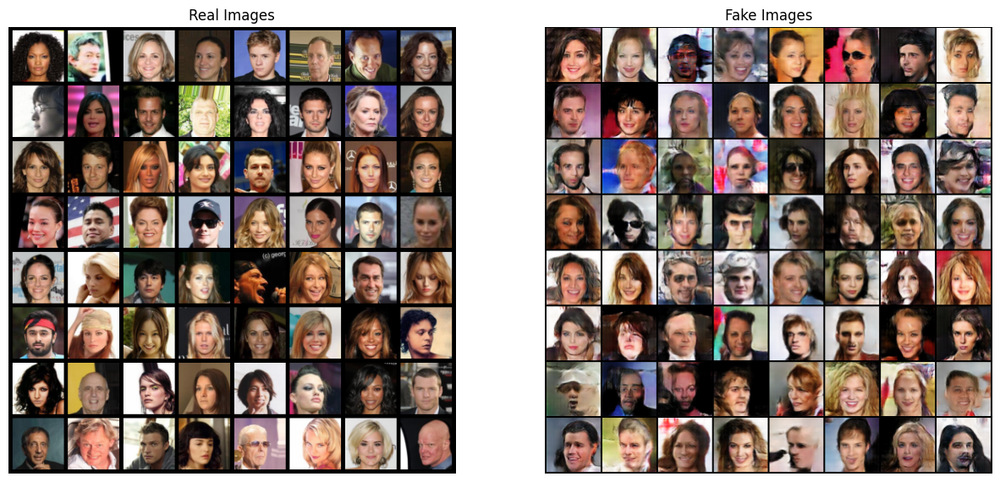

In [14]:
# dataloaderから本物の画像を取得する
real_batch = next(iter(dataloader))

# 本物画像をプロット
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# 最後のエポックから偽物画像をプロットする
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()